# OpenAI Gym

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#OpenAI-Gym-Intro" data-toc-modified-id="OpenAI-Gym-Intro-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>OpenAI Gym Intro</a></span></li><li><span><a href="#Gym-Environments" data-toc-modified-id="Gym-Environments-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Gym Environments</a></span></li><li><span><a href="#Naive-Random-Policy" data-toc-modified-id="Naive-Random-Policy-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Naive Random Policy</a></span></li><li><span><a href="#Simple-policies" data-toc-modified-id="Simple-policies-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Simple policies</a></span><ul class="toc-item"><li><span><a href="#logic-based" data-toc-modified-id="logic-based-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>logic based</a></span></li><li><span><a href="#parameterized-random" data-toc-modified-id="parameterized-random-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>parameterized random</a></span></li></ul></li></ul></div>

## OpenAI Gym Intro

In [1]:
import gym
print('OpenAI Gym:',gym.__version__)

OpenAI Gym: 0.10.5


In [2]:
all_env = list(gym.envs.registry.all())
print('Total Environments in Gym version {} : {}'
    .format(gym.__version__,len(all_env)))

Total Environments in Gym version 0.10.5 : 797


In [3]:
for e in list(all_env):
    print(e)

EnvSpec(Copy-v0)
EnvSpec(RepeatCopy-v0)
EnvSpec(ReversedAddition-v0)
EnvSpec(ReversedAddition3-v0)
EnvSpec(DuplicatedInput-v0)
EnvSpec(Reverse-v0)
EnvSpec(CartPole-v0)
EnvSpec(CartPole-v1)
EnvSpec(MountainCar-v0)
EnvSpec(MountainCarContinuous-v0)
EnvSpec(Pendulum-v0)
EnvSpec(Acrobot-v1)
EnvSpec(LunarLander-v2)
EnvSpec(LunarLanderContinuous-v2)
EnvSpec(BipedalWalker-v2)
EnvSpec(BipedalWalkerHardcore-v2)
EnvSpec(CarRacing-v0)
EnvSpec(Blackjack-v0)
EnvSpec(KellyCoinflip-v0)
EnvSpec(KellyCoinflipGeneralized-v0)
EnvSpec(FrozenLake-v0)
EnvSpec(FrozenLake8x8-v0)
EnvSpec(CliffWalking-v0)
EnvSpec(NChain-v0)
EnvSpec(Roulette-v0)
EnvSpec(Taxi-v2)
EnvSpec(GuessingGame-v0)
EnvSpec(HotterColder-v0)
EnvSpec(Reacher-v2)
EnvSpec(Pusher-v2)
EnvSpec(Thrower-v2)
EnvSpec(Striker-v2)
EnvSpec(InvertedPendulum-v2)
EnvSpec(InvertedDoublePendulum-v2)
EnvSpec(HalfCheetah-v2)
EnvSpec(Hopper-v2)
EnvSpec(Swimmer-v2)
EnvSpec(Walker2d-v2)
EnvSpec(Ant-v2)
EnvSpec(Humanoid-v2)
EnvSpec(HumanoidStandup-v2)
EnvSpec(FetchS

## Gym Environments

In [4]:
env = gym.make('CartPole-v0')

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.


In [5]:
print(env.action_space)

Discrete(2)


In [6]:
print(env.observation_space)

Box(4,)


In [7]:
observation = env.reset()
env.render()

True

In [8]:
env.close()

In [19]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (30,20)
import matplotlib.animation as anm
import JSAnimation.IPython_display as ipd
def env_render(env_frames):
    plt.figure()
    plot = plt.imshow(env_frames[0])
    plt.axis('off')
    def animate(i):
        plot.set_data(env_frames[i])

    anim = anm.FuncAnimation(plt.gcf(),
                             animate,
                             frames=len(env_frames),
                             interval=20,
                             repeat=True,
                             repeat_delay=20)
    display(ipd.display_animation(anim, default_mode='once'))

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Discrete(2)
Box(4,)



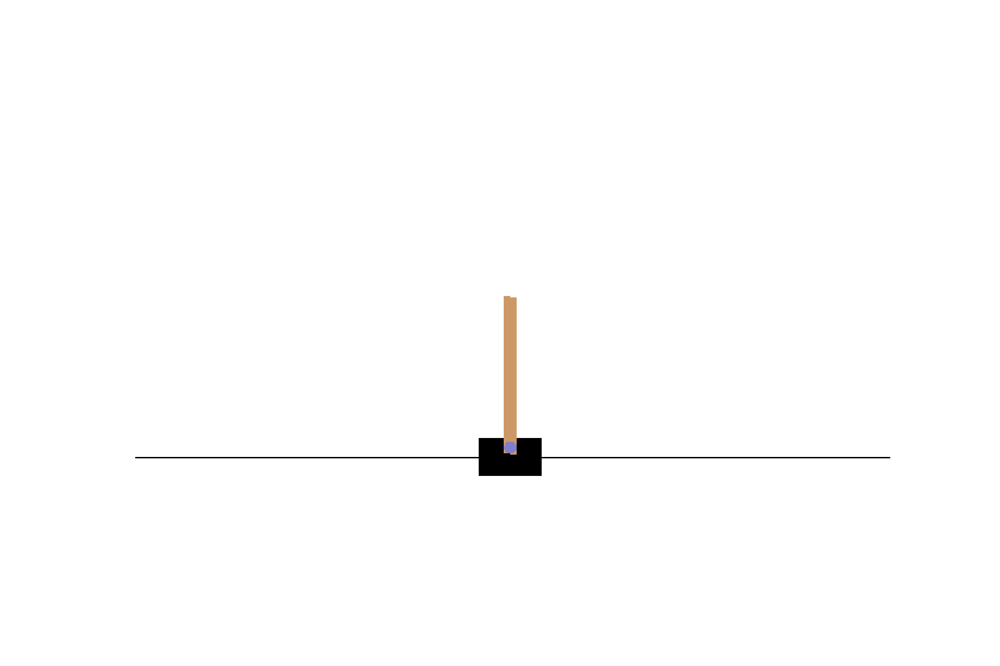

In [35]:
env = gym.make('CartPole-v0')
print(env.action_space)
print(env.observation_space)
env_frames = []
observation = env.reset()
env_frames.append(env.render(mode = 'rgb_array'))
env.close()

env_render(env_frames)

In [21]:
env = gym.make('FrozenLake-v0')
print(env.action_space)
print(env.observation_space)
observation = env.reset()
env.render()
env.close()

Discrete(4)
Discrete(16)

SFFF
FHFH
FFFH
HFFG


Discrete(6)
Box(210, 160, 3)



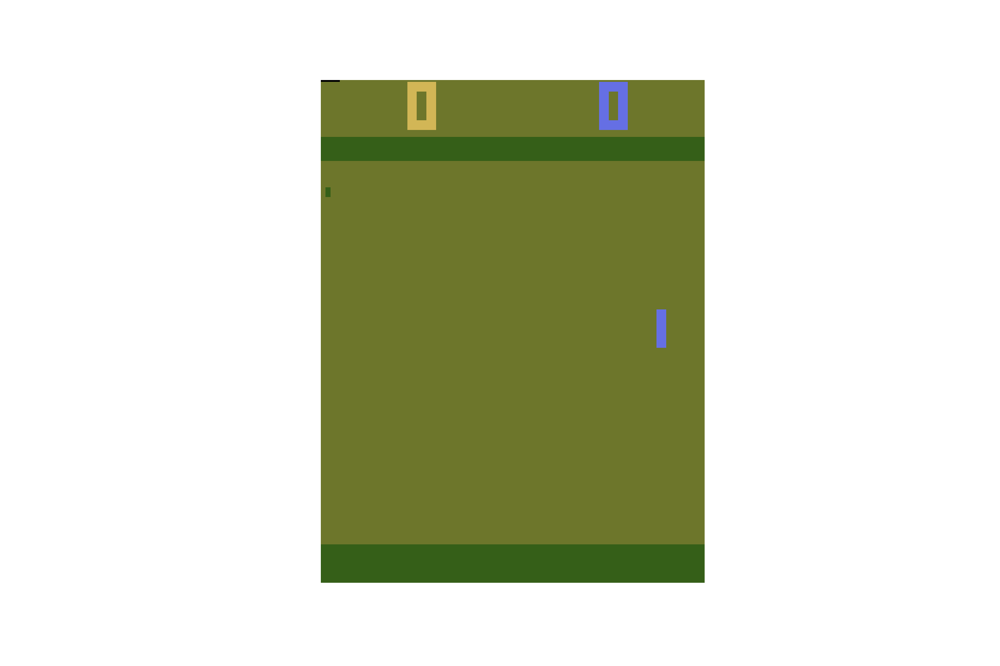

In [22]:
env = gym.make('Pong-v0')
print(env.action_space)
print(env.observation_space)
env_frames = []
observation = env.reset()
env_frames.append(env.render(mode = 'rgb_array'))
env.close()

env_render(env_frames)

Discrete(9)
Box(210, 160, 3)



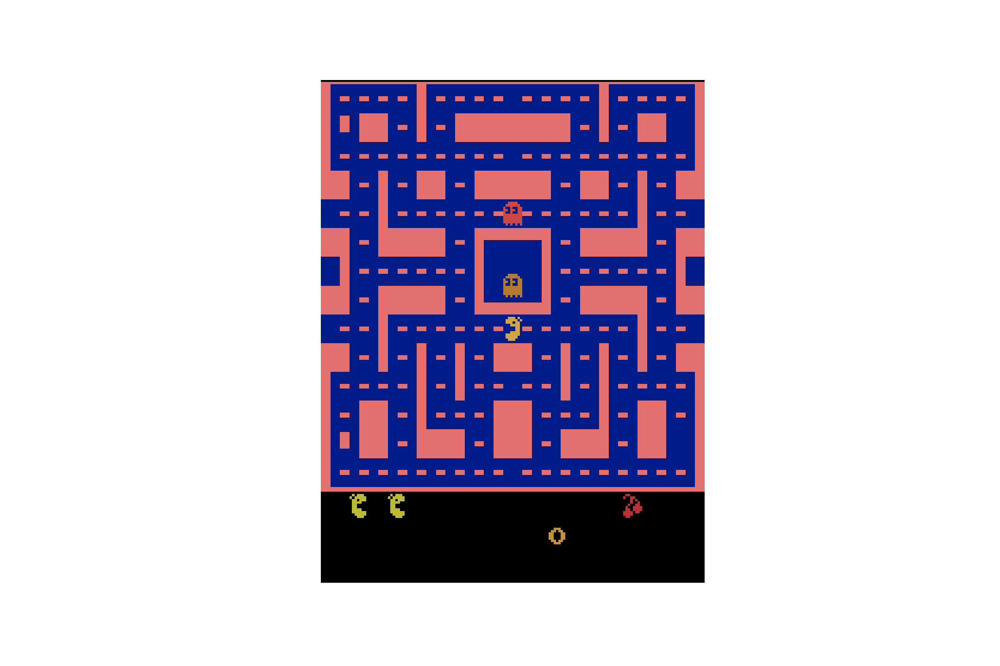

In [23]:
env = gym.make('MsPacman-v0')
print(env.action_space)
print(env.observation_space)
env_frames = []
observation = env.reset()
env_frames.append(env.render(mode = 'rgb_array'))
env.close()

env_render(env_frames)

## Naive Random Policy

In [24]:
def policy_random(env,obs):
    return env.action_space.sample()

# t_max = 0 : run until done
# t_max > 0 : run each episode for t_max steps at max
# g_max = 0 : run until done
# g_max > 0 : run each episode for g_max return at max
import numpy as np
def experiment(env, policy, n_episodes=1, g_max=0, t_max=0):
    
    frames=[None] * n_episodes
    returns=np.empty(shape=(n_episodes))
    #env = gym.make('CartPole-v0')
    
    for i in range(n_episodes):
        obs = env.reset()
        done = False
        f = []
        g = 0
        t = 0
        while not done:
            action = policy(env,obs)
            obs, reward, done, info = env.step(action)
            f.append(env.render(mode = 'rgb_array'))
            g += reward
            t += 1
            if g_max > 0 and g > g_max:
                break
            if t_max > 0 and t > t_max:
                break
        returns[i]= g
        frames[i] = f
        
    print('Policy:{}, Return(G)- Mean: {} Min:{}, Max:{}'
          .format(policy.__name__,
                  np.mean(returns),
                  np.min(returns),
                  np.max(returns)))

    return returns, frames

In [25]:
env = gym.make('CartPole-v0')
returns, frames = experiment(env, policy_random)
env.close()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Policy:policy_random, Return(G)- Mean: 27.0 Min:27.0, Max:27.0



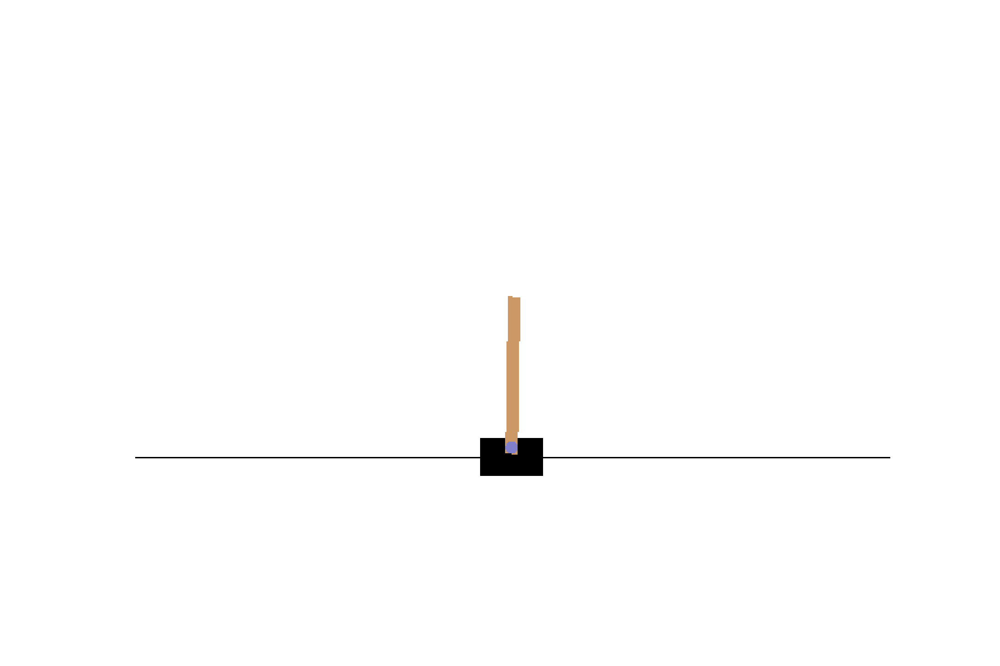
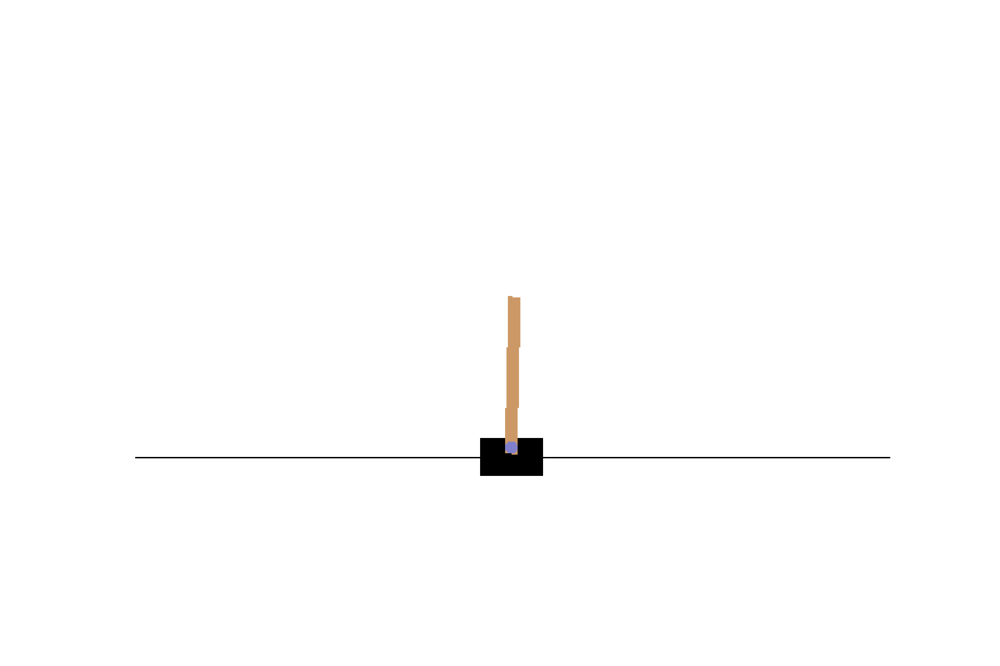
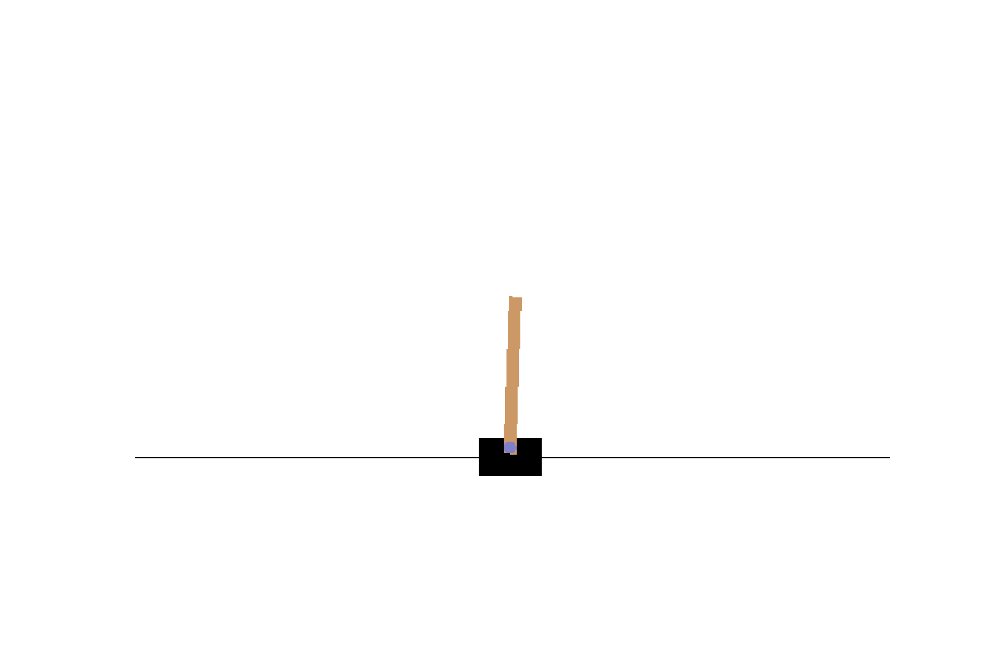
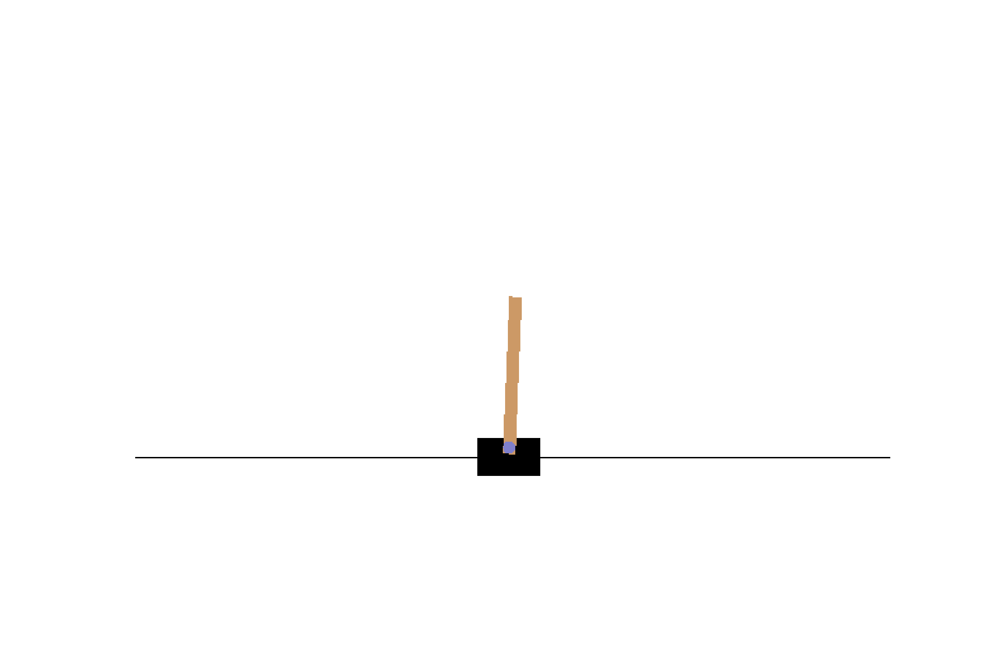
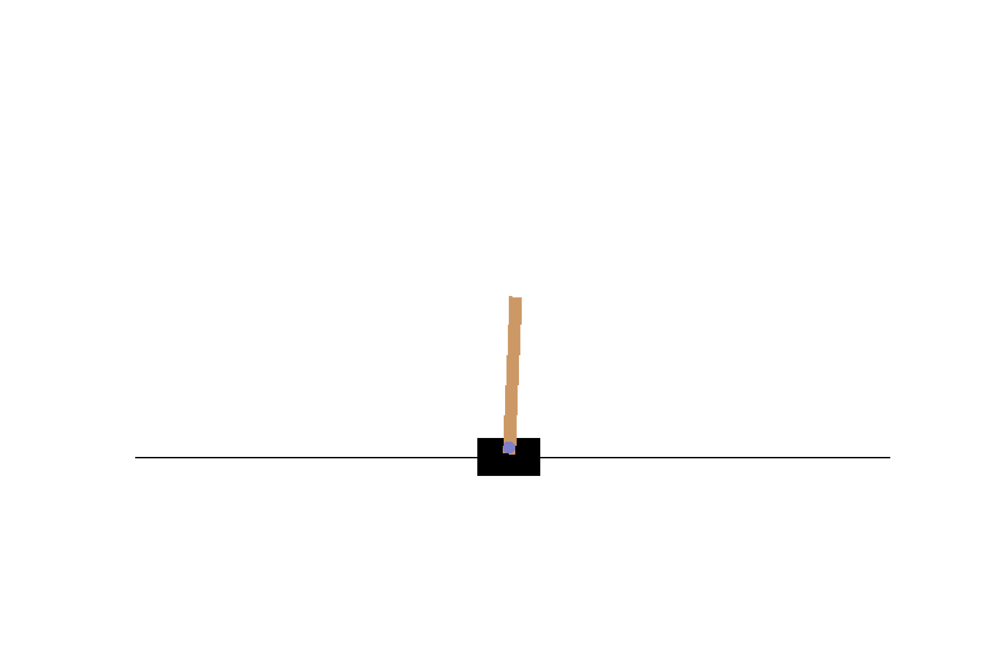
...
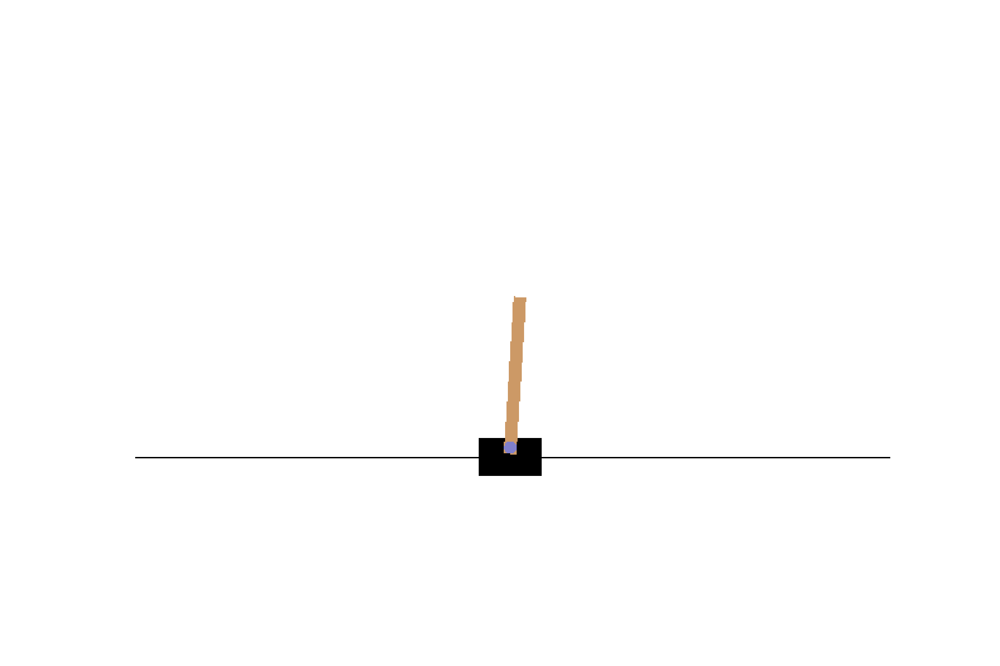
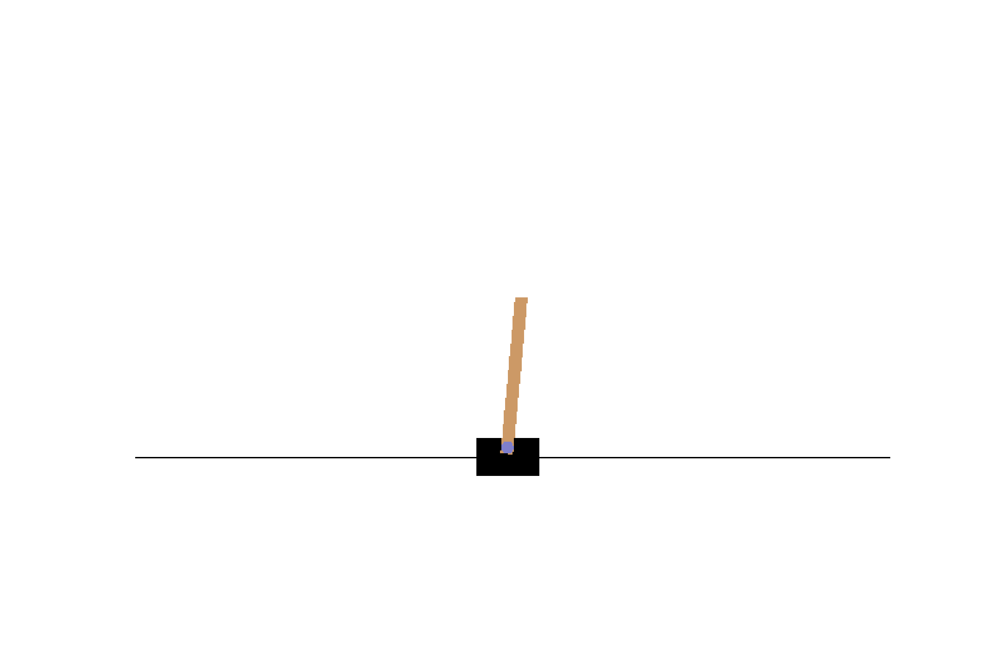
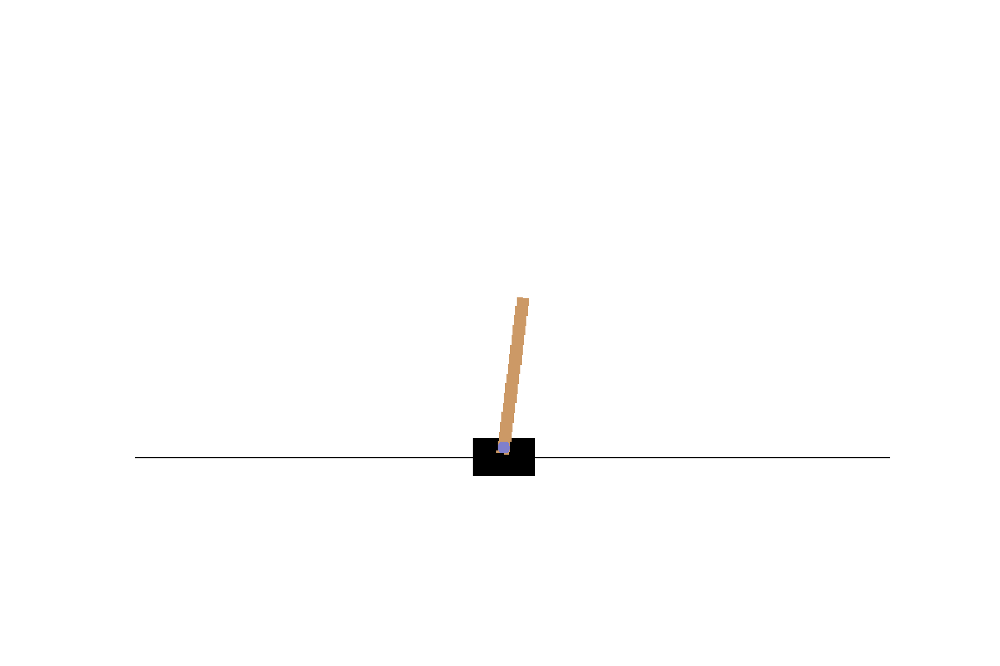
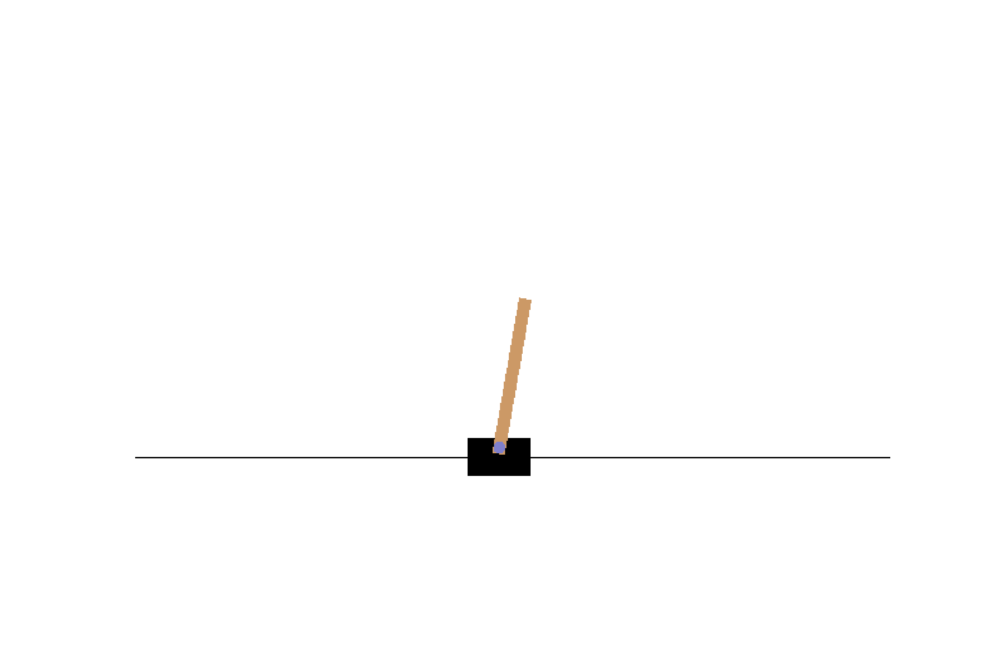
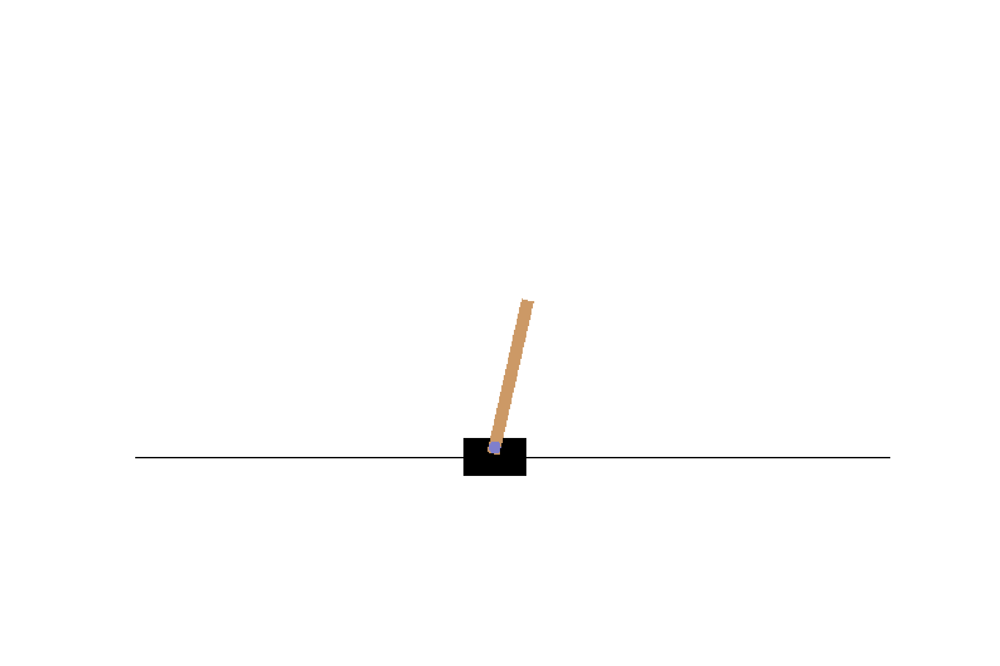

In [26]:
env_render(frames[0])

In [27]:
env = gym.make('Pong-v0')
returns, frames = experiment(env, policy_random)
env.close()

Policy:policy_random, Return(G)- Mean: -20.0 Min:-20.0, Max:-20.0



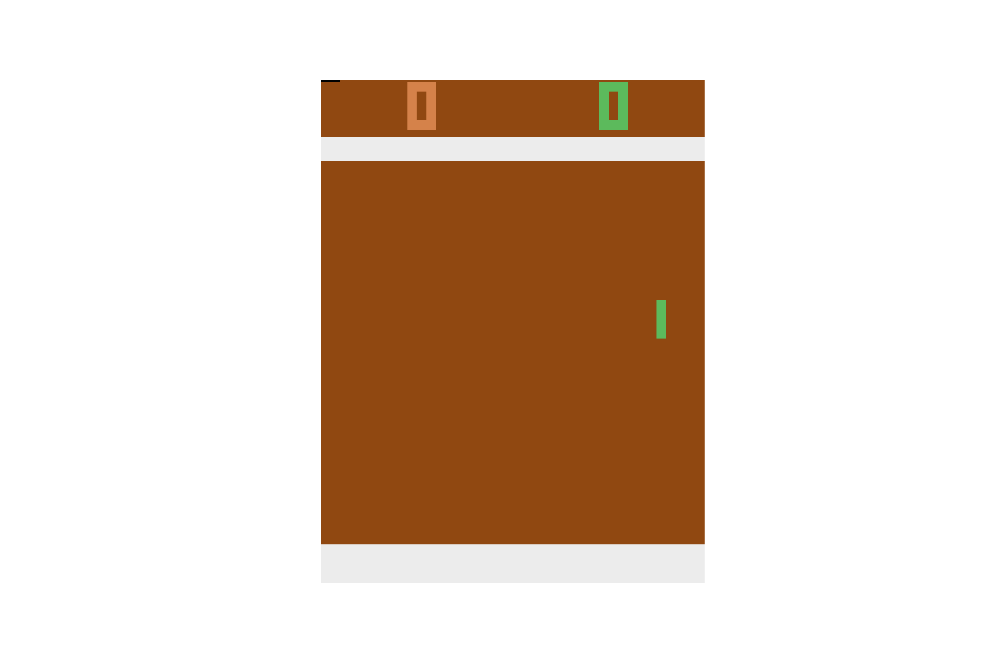
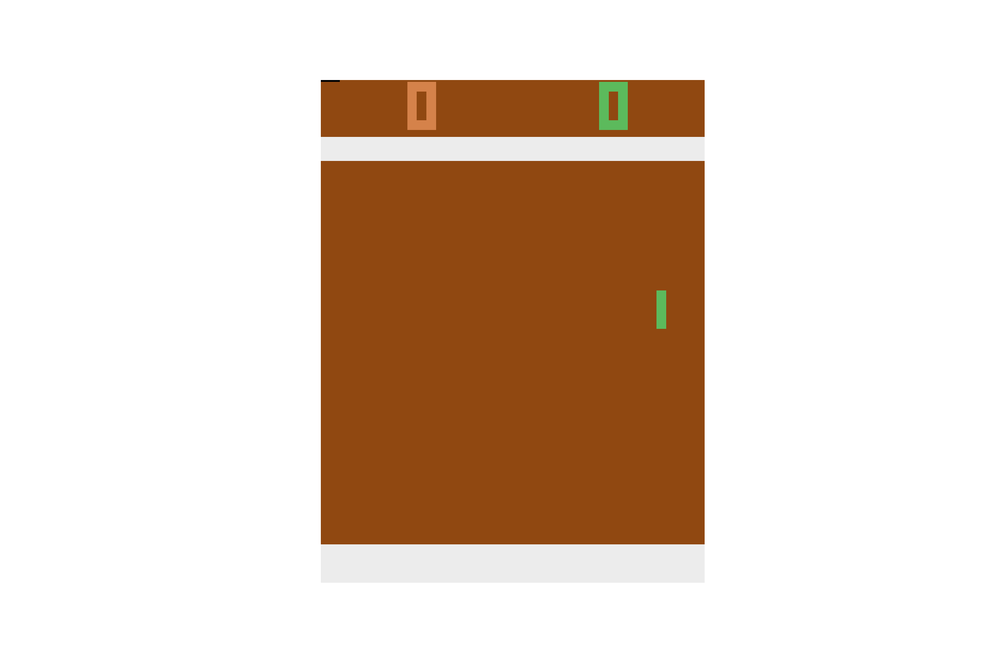
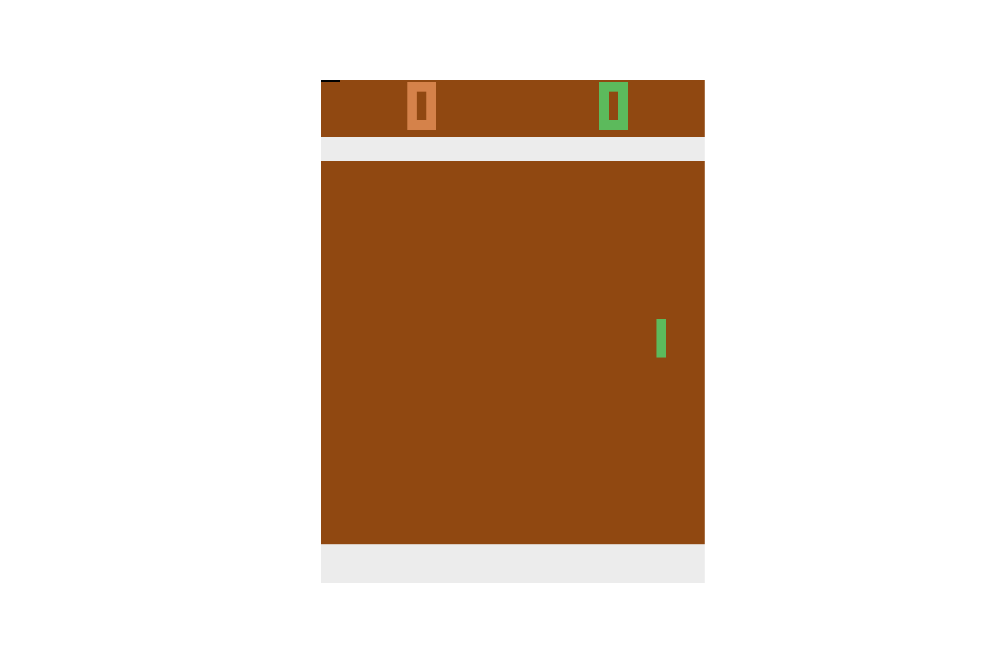
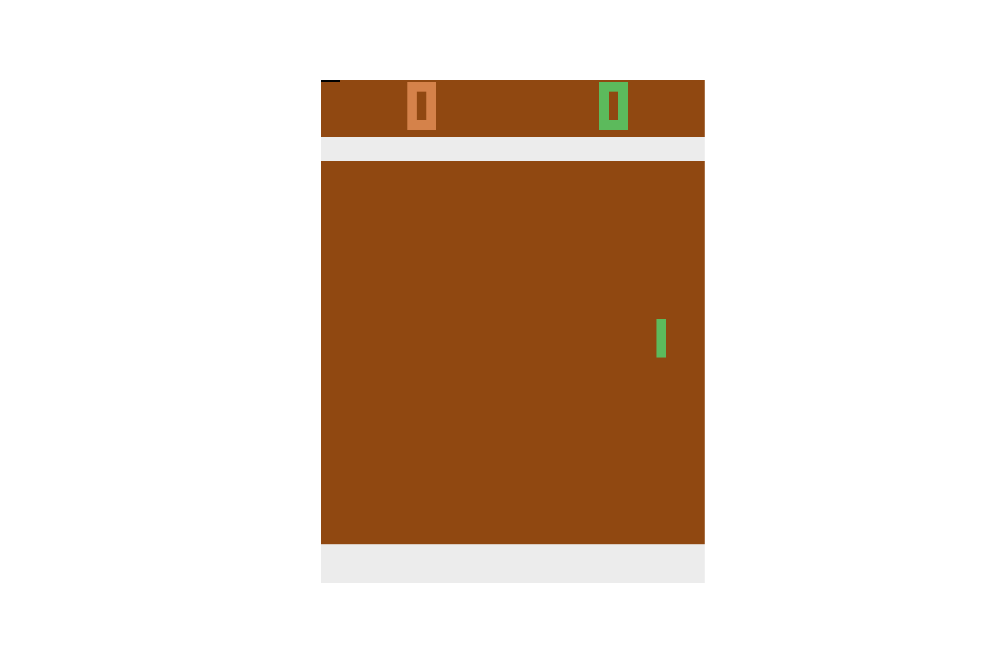
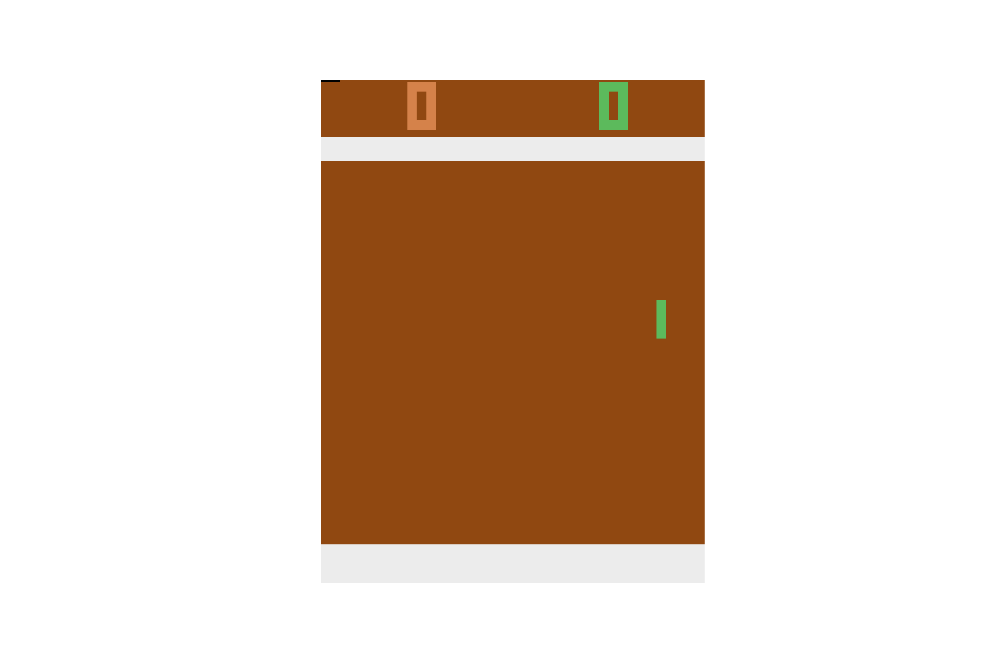
...
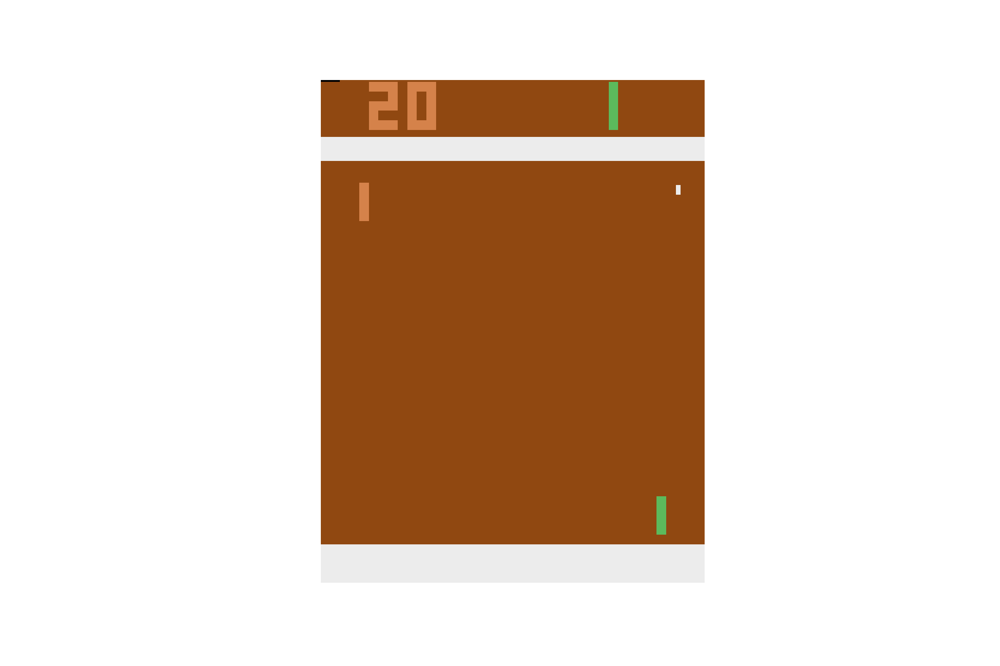
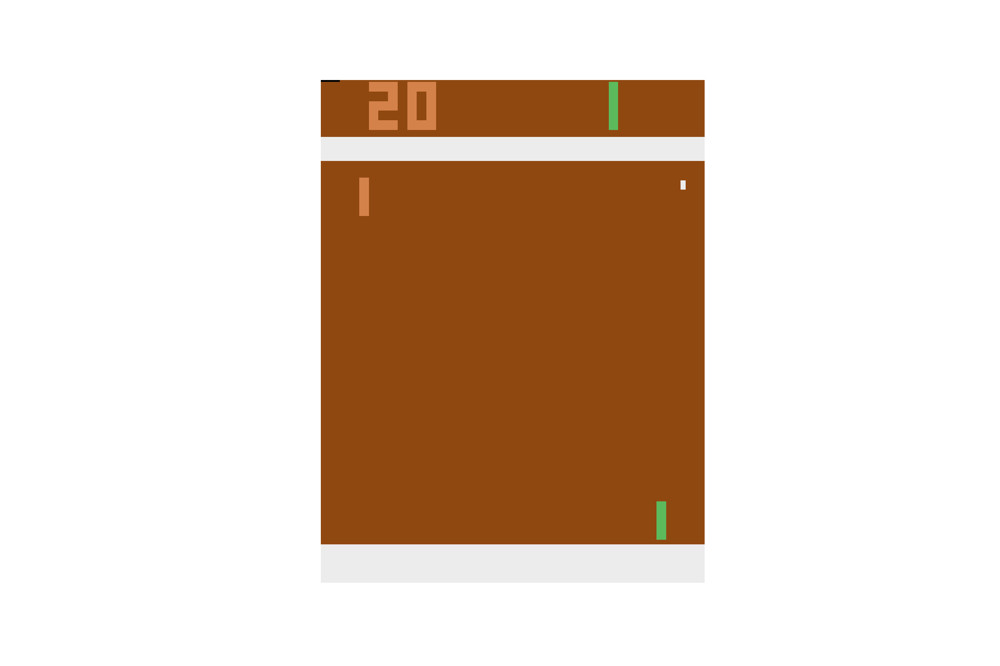
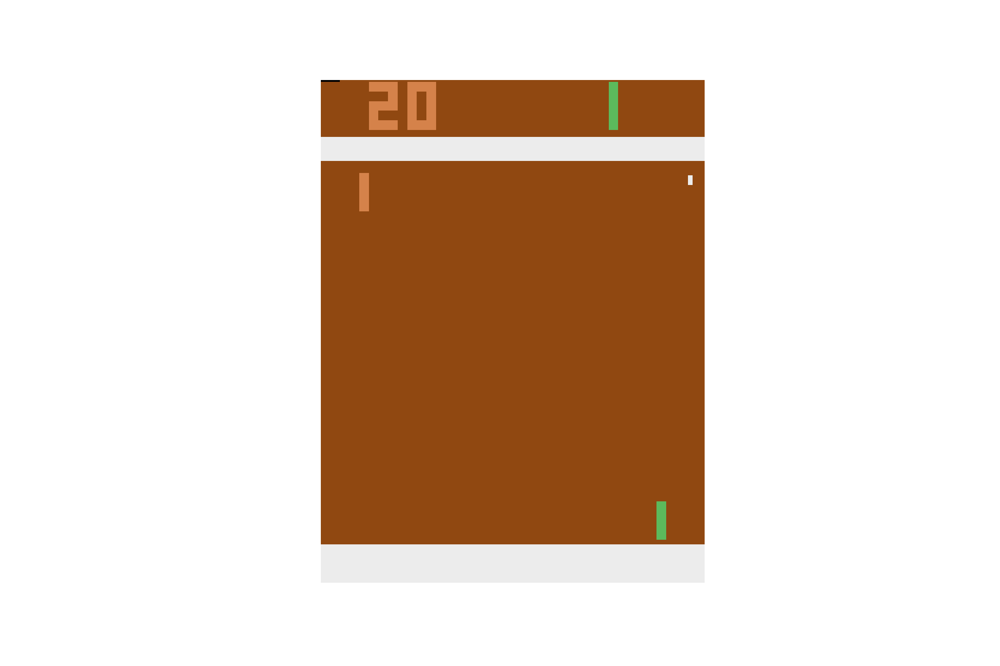
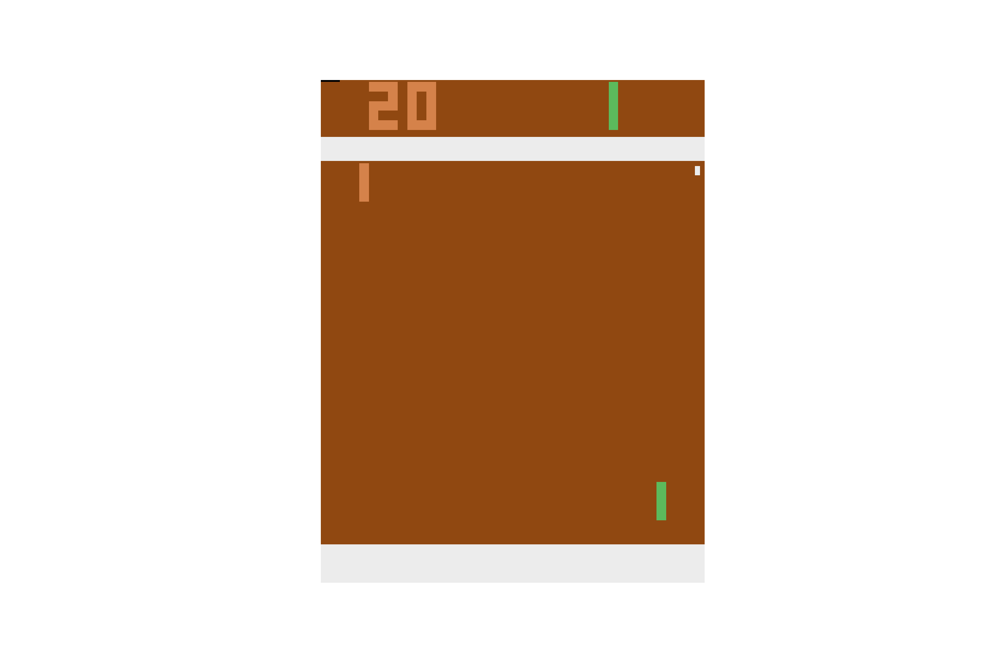
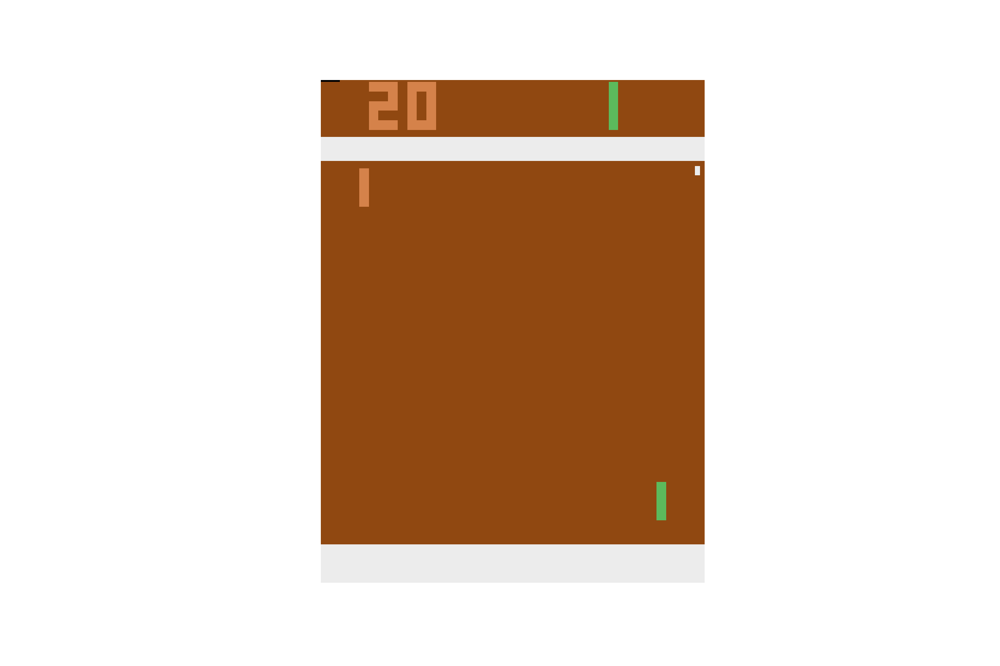

In [28]:
env_render(frames[0])

In [29]:
env = gym.make('MsPacman-v0')
returns, frames = experiment(env, policy_random)
env.close()

Policy:policy_random, Return(G)- Mean: 190.0 Min:190.0, Max:190.0



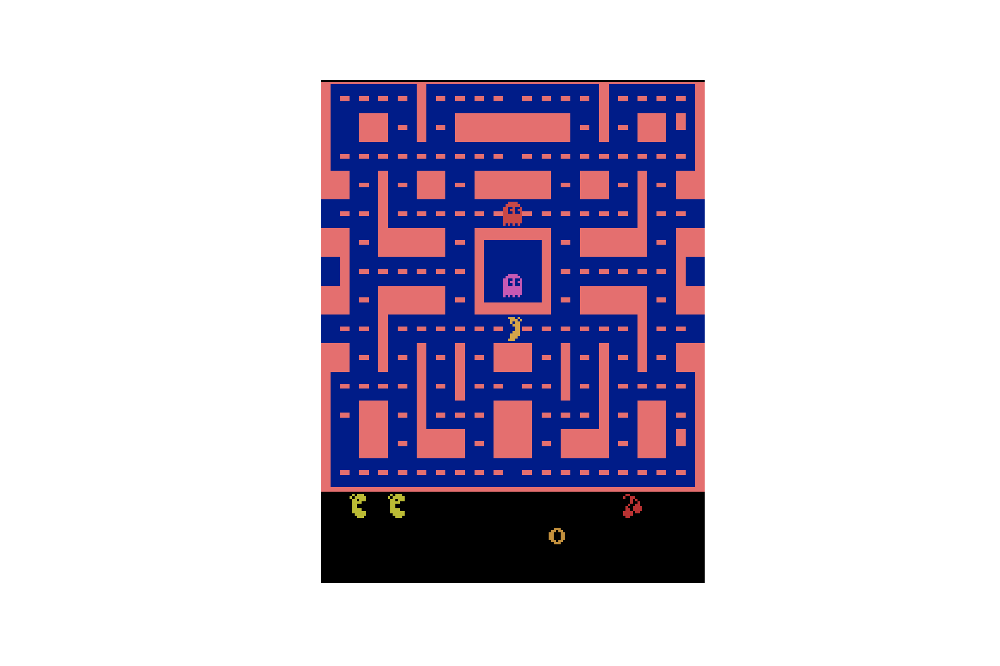
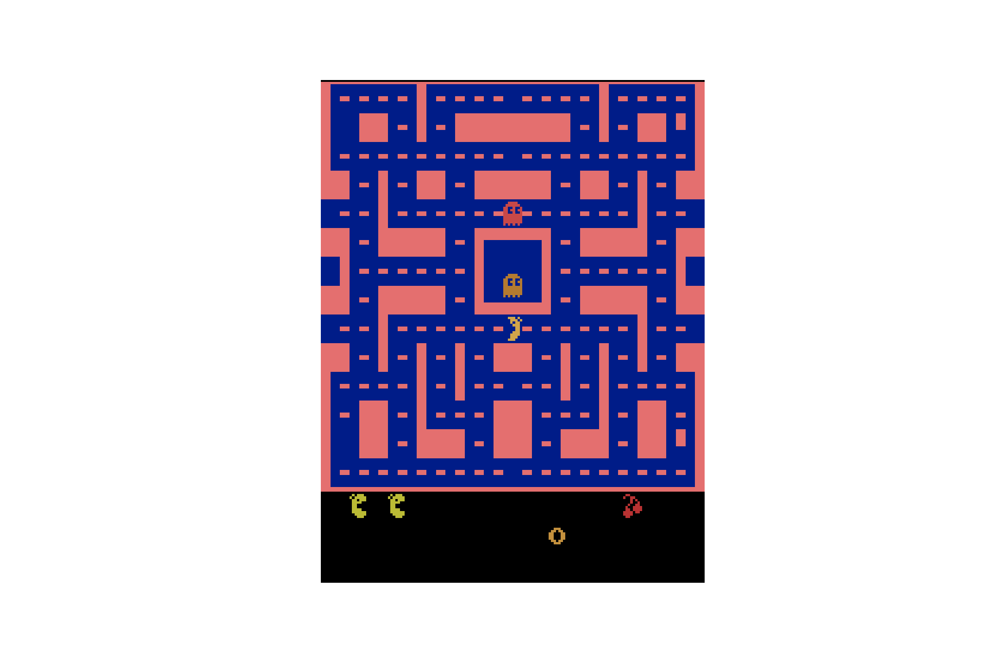
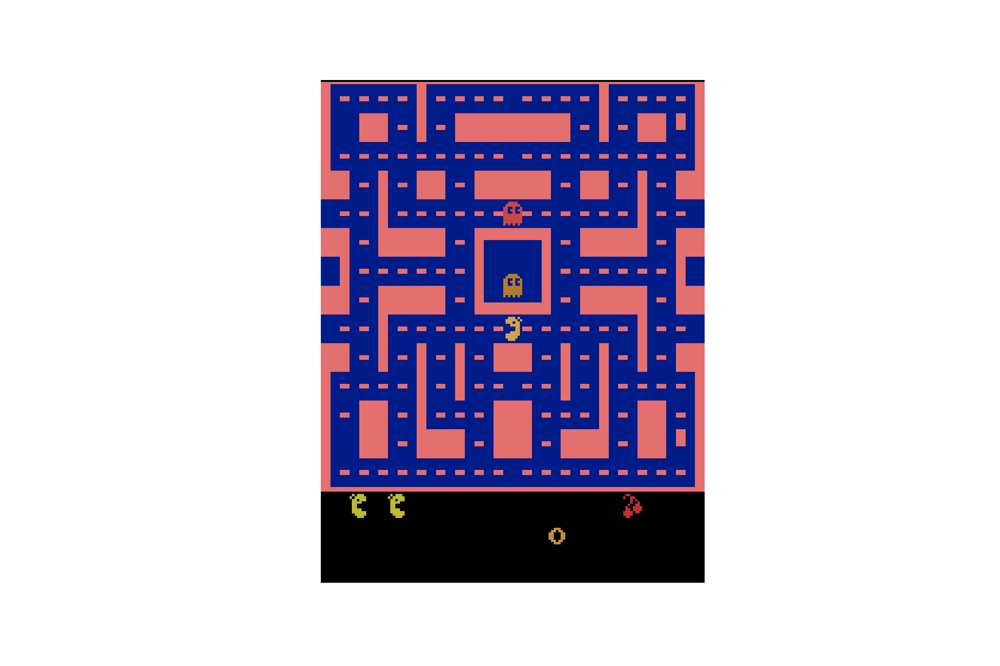
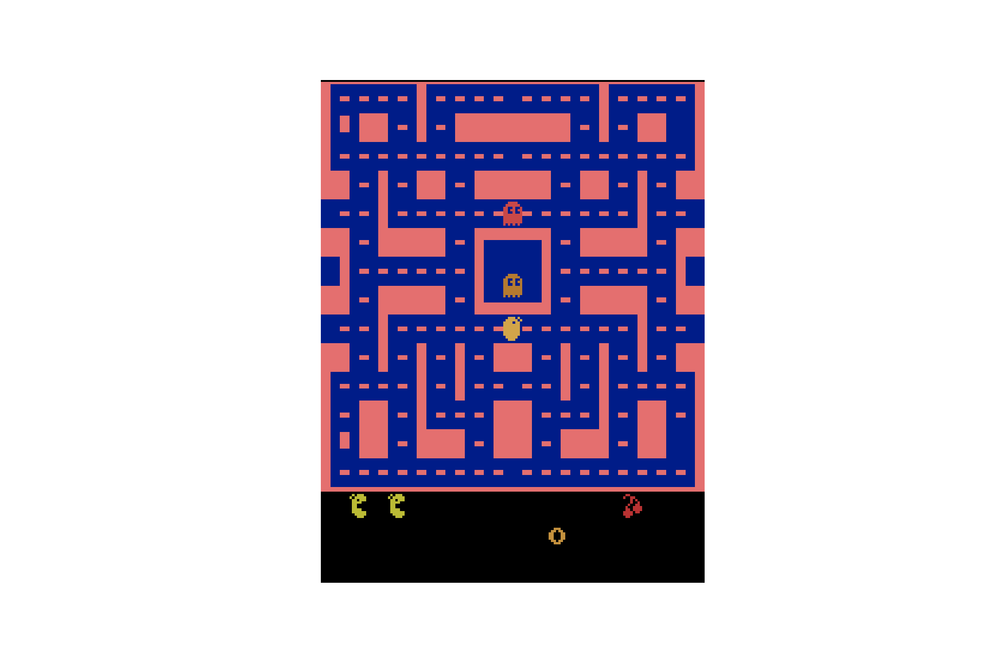
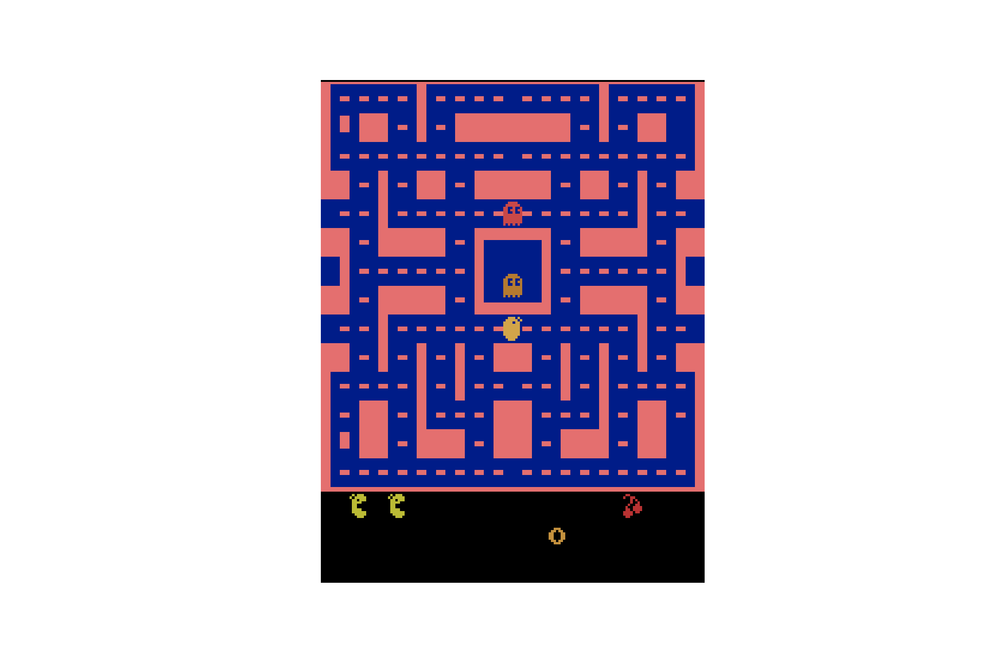
...
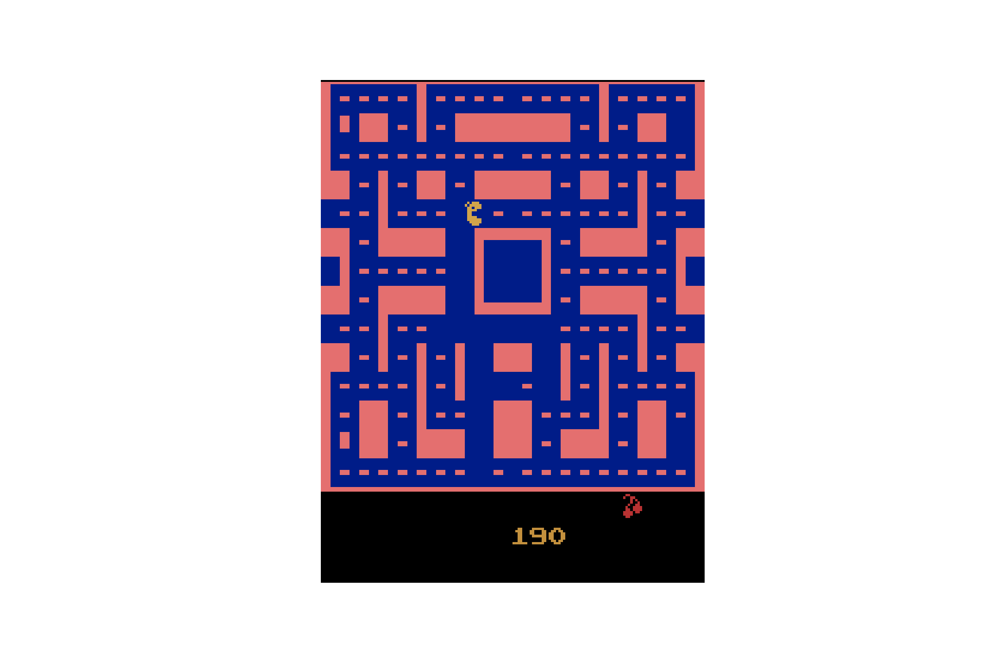
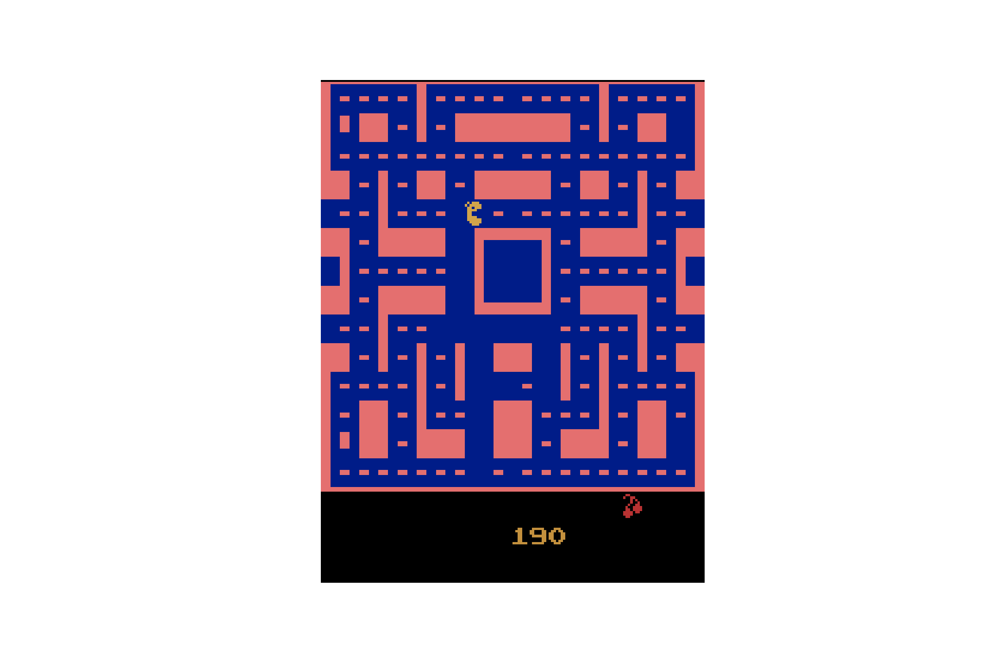
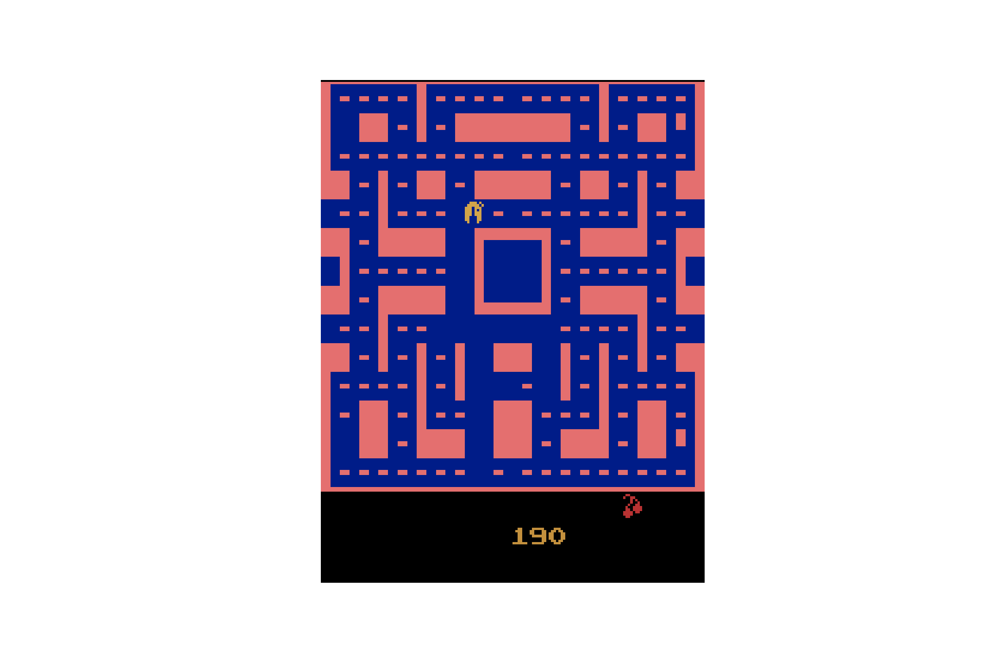
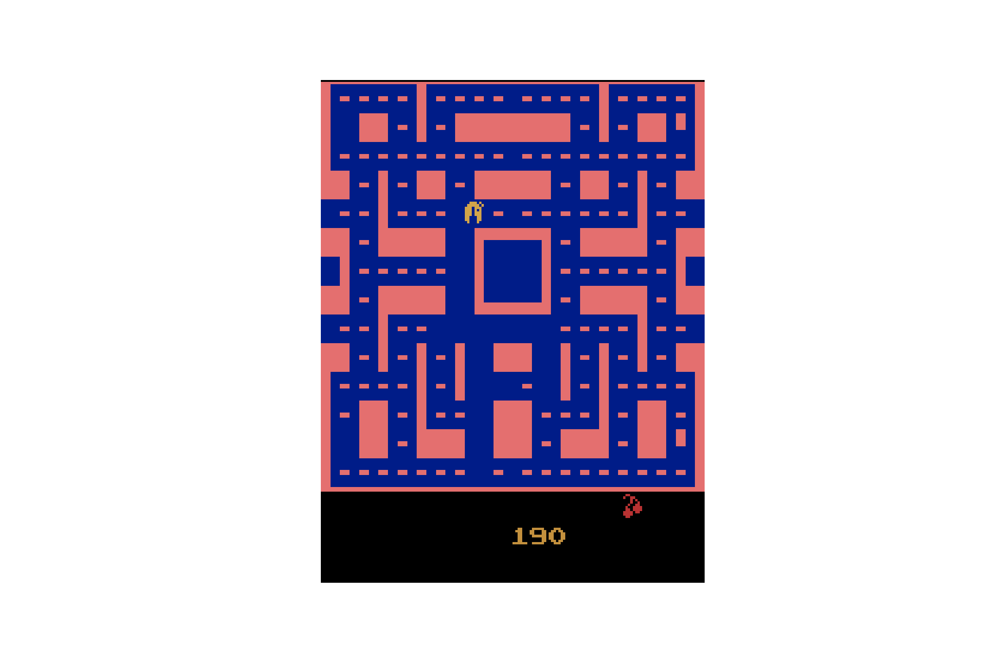
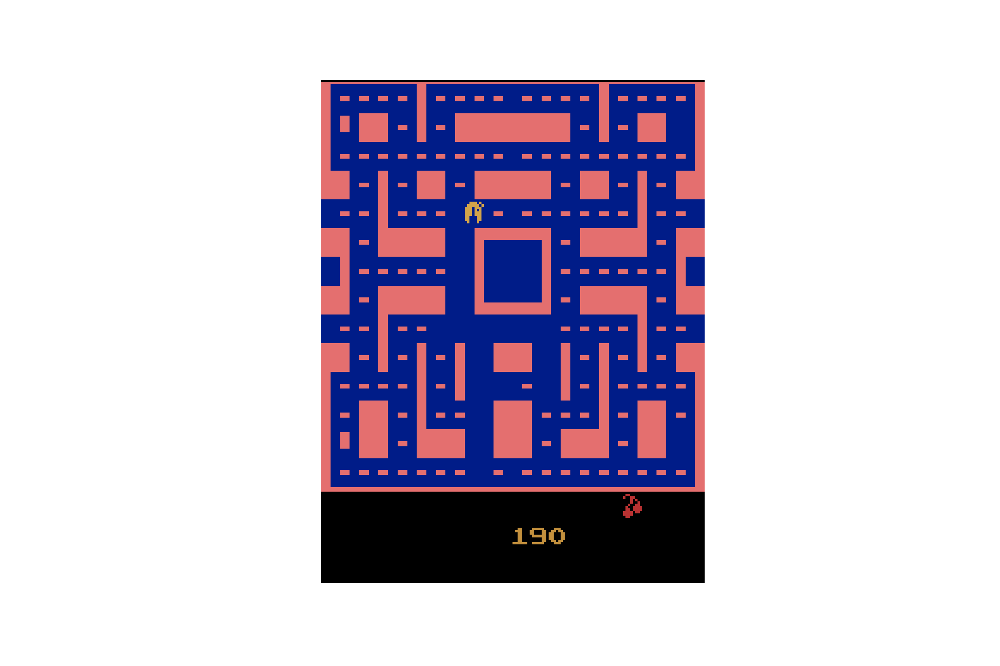

In [30]:
env_render(frames[0])

In [31]:
n_episodes = 100
env = gym.make('CartPole-v0')
returns, frames = experiment(env, policy_random, n_episodes)
env.close()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Policy:policy_random, Return(G)- Mean: 20.28 Min:9.0, Max:50.0


In [32]:
n_episodes = 100
t_max = 10
env = gym.make('CartPole-v0')
returns, frames = experiment(env, policy_random, n_episodes, t_max=t_max)
env.close()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Policy:policy_random, Return(G)- Mean: 10.93 Min:8.0, Max:11.0


In [34]:
n_episodes = 100
g_max = 30
env = gym.make('CartPole-v0')
returns, frames = experiment(env, policy_random, n_episodes, g_max=g_max)
env.close()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Policy:policy_random, Return(G)- Mean: 20.17 Min:10.0, Max:31.0


## Simple policies

### logic based

In [36]:
def policy_logic(env,obs):
    return 1 if obs[2] > 0 else 0
def policy_random(env,obs):
    return env.action_space.sample()

In [37]:
# experiment function without collecting frames

# t_max = 0 : run until done
# t_max > 0 : run each episode for t_max steps at max
# g_max = 0 : run until done
# g_max > 0 : run each episode for g_max return at max
import numpy as np
def experiment(env, policy, n_episodes=1, g_max=0, t_max=0):
    
    #frames=[None] * n_episodes
    returns=np.empty(shape=(n_episodes))
    #env = gym.make('CartPole-v0')
    
    for i in range(n_episodes):
        obs = env.reset()
        done = False
        #f = []
        g = 0
        t = 0
        while not done:
            action = policy(env,obs)
            obs, reward, done, info = env.step(action)
            #f.append(env.render(mode = 'rgb_array'))
            g += reward
            t += 1
            if g_max > 0 and g > g_max:
                break
            if t_max > 0 and t > t_max:
                break
        returns[i]= g
        #frames[i] = f
        
    print('Policy:{}, Return(G)- Mean: {} Min:{}, Max:{}'
          .format(policy.__name__,
                  np.mean(returns),
                  np.min(returns),
                  np.max(returns)))

    return returns #, frames

In [40]:
n_episodes = 100
g_max = 10000
env = gym.make('CartPole-v0')
returns=experiment(env,policy_random, n_episodes, g_max)
returns=experiment(env,policy_logic, n_episodes, g_max)
env.close()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Policy:policy_random, Return(G)- Mean: 24.5 Min:9.0, Max:64.0
Policy:policy_logic, Return(G)- Mean: 42.85 Min:25.0, Max:68.0


### parameterized random

In [44]:
def policy_logic(theta,obs):
    return 1 if obs[2] > 0 else 0
def policy_theta_random(theta,obs):
    return 0 if np.matmul(theta,obs) < 0 else 1

In [45]:
# experiment function with parameters

# t_max = 0 : run until done
# t_max > 0 : run each episode for t_max steps at max
# g_max = 0 : run until done
# g_max > 0 : run each episode for g_max return at max
import numpy as np
def experiment(env, policy, n_episodes=1, g_max=0, t_max=0):
    
    returns=np.empty(shape=(n_episodes))
    
    for i in range(n_episodes):
        obs = env.reset()
        done = False
        g = 0
        t = 0
        theta = np.random.rand(4) * 2 - 1
        while not done:
            action = policy(theta,obs)
            obs, reward, done, info = env.step(action)
            g += reward
            t += 1
            if g_max > 0 and g > g_max:
                break
            if t_max > 0 and t > t_max:
                break
        returns[i]= g
        
    print('Policy:{}, Return(G)- Mean: {} Min:{}, Max:{}'
          .format(policy.__name__,
                  np.mean(returns),
                  np.min(returns),
                  np.max(returns)))

    return returns, theta_best

In [46]:
n_episodes = 100
g_max = 10000
env = gym.make('CartPole-v0')
returns=experiment(env,policy_theta_random, n_episodes, g_max)
returns=experiment(env,policy_logic, n_episodes, g_max)
env.close()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
Policy:policy_theta_random, Return(G)- Mean: 48.41 Min:8.0, Max:200.0
Policy:policy_logic, Return(G)- Mean: 42.98 Min:25.0, Max:68.0
